Source: https://github.com/google/prompt-to-prompt/blob/main/null_text_w_ptp.ipynb

 # Requirements, imports and loads

In [ ]:
!pip install xformers

In [ ]:
!pip install diffusers==0.8.1

In [ ]:
!pip install transformers

In [ ]:
!pip install accelerate

In [ ]:
!wget https://raw.githubusercontent.com/google/prompt-to-prompt/main/seq_aligner.py -O seq_aligner.py
!wget https://raw.githubusercontent.com/google/prompt-to-prompt/main/ptp_utils.py -O ptp_utils.py

In [ ]:
!gdown --fuzzy "https://drive.google.com/file/d/1r-eToqw2g9kRI7Ohj25DgHuPwXGL20CZ/view?usp=sharing"
!gdown --fuzzy "https://drive.google.com/file/d/1Uu1RkeyJfBnnyi9DNLxzCPFNOqfD-7VO/view?usp=sharing"
!gdown --fuzzy "https://drive.google.com/file/d/1jGtvZn7hKgU7VmcEzkh5JfLqukup5hSH/view?usp=sharing"
!gdown --fuzzy "https://drive.google.com/file/d/1LLNJ4hC4z3BPR0NV5qM28tiHAyRNPZk1/view?usp=sharing"
!gdown --fuzzy "https://drive.google.com/file/d/1nWhF-KQYNfxnNx7zPC7PJmZSHatMA0aX/view?usp=sharing"
!gdown --fuzzy "https://drive.google.com/file/d/1S2067l5_sgNqY5r7GGWtUt4PRGmo1TSn/view?usp=sharing"
!gdown --fuzzy "https://drive.google.com/file/d/11QOUgiSXAzsOKgrGQqTrYrYTq4a-7p_6/view?usp=share_link"
!gdown --fuzzy "https://drive.google.com/file/d/1IieqtKKazHWeRgXKLw8U0-8PPeaT8xMX/view?usp=sharing"
!gdown --fuzzy "https://drive.google.com/file/d/14YyAwDyJshY4VT1fa8nUVRmDvQ26sZ8V/view?usp=sharing"

In [ ]:
from typing import Optional, Union, Tuple, List, Callable, Dict
from tqdm.notebook import tqdm
import torch
from diffusers import StableDiffusionPipeline, DDIMScheduler
import torch.nn.functional as nnf
import numpy as np
import abc
import ptp_utils
import seq_aligner
import shutil
from torch.optim.adam import Adam
from PIL import Image

# Null-text Inversion with Null-text Embeddings Finetuning

In [ ]:
scheduler = DDIMScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", clip_sample=False, set_alpha_to_one=False)
LOW_RESOURCE = False 
NUM_DDIM_STEPS = 50
GUIDANCE_SCALE = 7.5
MAX_NUM_WORDS = 77
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
ldm_stable = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", scheduler=scheduler).to(device)
try:
    ldm_stable.disable_xformers_memory_efficient_attention()
except AttributeError:
    print("Attribute disable_xformers_memory_efficient_attention() is missing")
tokenizer = ldm_stable.tokenizer

## Null Text Inversion code

In [ ]:
from typing import List 

class LocalBlend:
    
    def get_mask(self, maps, alpha, use_pool):
        k = 1
        maps = (maps * alpha).sum(-1).mean(1)
        if use_pool:
            maps = nnf.max_pool2d(maps, (k * 2 + 1, k * 2 +1), (1, 1), padding=(k, k))
        mask = nnf.interpolate(maps, size=(x_t.shape[2:]))
        mask = mask / mask.max(2, keepdims=True)[0].max(3, keepdims=True)[0]
        mask = mask.gt(self.th[1-int(use_pool)])
        mask = mask[:1] + mask
        return mask
    
    def __call__(self, x_t, attention_store):
        self.counter += 1
        if self.counter > self.start_blend:
           
            maps = attention_store["down_cross"][2:4] + attention_store["up_cross"][:3]
            maps = [item.reshape(self.alpha_layers.shape[0], -1, 1, 16, 16, MAX_NUM_WORDS) for item in maps]
            maps = torch.cat(maps, dim=1)
            mask = self.get_mask(maps, self.alpha_layers, True)
            if self.substruct_layers is not None:
                maps_sub = ~self.get_mask(maps, self.substruct_layers, False)
                mask = mask * maps_sub
            mask = mask.float()
            x_t = x_t[:1] + mask * (x_t - x_t[:1])
        return x_t
       
    def __init__(self, prompts: List[str], words: [List[List[str]]], substruct_words=None, start_blend=0.2, th=(.3, .3)):
        alpha_layers = torch.zeros(len(prompts),  1, 1, 1, 1, MAX_NUM_WORDS)
        for i, (prompt, words_) in enumerate(zip(prompts, words)):
            if type(words_) is str:
                words_ = [words_]
            for word in words_:
                ind = ptp_utils.get_word_inds(prompt, word, tokenizer)
                alpha_layers[i, :, :, :, :, ind] = 1
        
        if substruct_words is not None:
            substruct_layers = torch.zeros(len(prompts),  1, 1, 1, 1, MAX_NUM_WORDS)
            for i, (prompt, words_) in enumerate(zip(prompts, substruct_words)):
                if type(words_) is str:
                    words_ = [words_]
                for word in words_:
                    ind = ptp_utils.get_word_inds(prompt, word, tokenizer)
                    substruct_layers[i, :, :, :, :, ind] = 1
            self.substruct_layers = substruct_layers.to(device)
        else:
            self.substruct_layers = None
        self.alpha_layers = alpha_layers.to(device)
        self.start_blend = int(start_blend * NUM_DDIM_STEPS)
        self.counter = 0 
        self.th=th
        
class EmptyControl:
    
    
    def step_callback(self, x_t):
        return x_t
    
    def between_steps(self):
        return
    
    def __call__(self, attn, is_cross: bool, place_in_unet: str):
        return attn

    
class AttentionControl(abc.ABC):
    
    def step_callback(self, x_t):
        return x_t
    
    def between_steps(self):
        return
    
    @property
    def num_uncond_att_layers(self):
        return self.num_att_layers if LOW_RESOURCE else 0
    
    @abc.abstractmethod
    def forward (self, attn, is_cross: bool, place_in_unet: str):
        raise NotImplementedError

    def __call__(self, attn, is_cross: bool, place_in_unet: str):
        if self.cur_att_layer >= self.num_uncond_att_layers:
            if LOW_RESOURCE:
                attn = self.forward(attn, is_cross, place_in_unet)
            else:
                h = attn.shape[0]
                attn[h // 2:] = self.forward(attn[h // 2:], is_cross, place_in_unet)
        self.cur_att_layer += 1
        if self.cur_att_layer == self.num_att_layers + self.num_uncond_att_layers:
            self.cur_att_layer = 0
            self.cur_step += 1
            self.between_steps()
        return attn
    
    def reset(self):
        self.cur_step = 0
        self.cur_att_layer = 0

    def __init__(self):
        self.cur_step = 0
        self.num_att_layers = -1
        self.cur_att_layer = 0
        

class AttentionStore(AttentionControl):

    @staticmethod
    def get_empty_store():
        return {"down_cross": [], "mid_cross": [], "up_cross": [],
                "down_self": [],  "mid_self": [],  "up_self": []}

    def forward(self, attn, is_cross: bool, place_in_unet: str):
        key = f"{place_in_unet}_{'cross' if is_cross else 'self'}"
        if attn.shape[1] <= 32 ** 2:  # avoid memory overhead
            self.step_store[key].append(attn)
        return attn

    def between_steps(self):
        if len(self.attention_store) == 0:
            self.attention_store = self.step_store
        else:
            for key in self.attention_store:
                for i in range(len(self.attention_store[key])):
                    self.attention_store[key][i] += self.step_store[key][i]
        self.step_store = self.get_empty_store()

    def get_average_attention(self):
        average_attention = {key: [item / self.cur_step for item in self.attention_store[key]] for key in self.attention_store}
        return average_attention

    def reset(self):
        super(AttentionStore, self).reset()
        self.step_store = self.get_empty_store()
        self.attention_store = {}

    def __init__(self):
        super(AttentionStore, self).__init__()
        self.step_store = self.get_empty_store()
        self.attention_store = {}

In [ ]:
# ---
# a function for generating a simple image, without prompt-to-prompt specific attention controllers
# ---
@torch.no_grad()
def gen_image(
    model,
    text_embeddings,
    uncond_embeddings,
    controller = AttentionStore(),
    num_inference_steps = 50,
    guidance_scale = 7.5,
    generator = None,
    latent = None,
    start_time = 50,
    return_type = 'image'
):
    batch_size = text_embeddings.shape[0] if len(text_embeddings.shape) == 3 else 1
    ptp_utils.register_attention_control(model, controller)
    height = width = 512

    latent, latents = ptp_utils.init_latent(latent, model, height, width, generator, batch_size)
    scheduler = DDIMScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", clip_sample=False, set_alpha_to_one=False)
    scheduler.set_timesteps(num_inference_steps)
    for i, t in enumerate(tqdm(scheduler.timesteps[-start_time:])):
        context = torch.cat([uncond_embeddings[i].expand(*text_embeddings.shape), text_embeddings])
        latents = ptp_utils.diffusion_step(model, controller, latents, context, t, guidance_scale, low_resource=False)
        
    if return_type == 'image':
        image = ptp_utils.latent2image(model.vae, latents)
    else:
        image = latents

    ptp_utils.register_attention_control(model, EmptyControl())
    return image, latent

In [ ]:
from copy import copy

def load_512(image_path, left=0, right=0, top=0, bottom=0):
    if type(image_path) is str:
        image = np.array(Image.open(image_path))[:, :, :3]
    else:
        image = image_path
    h, w, c = image.shape
    left = min(left, w-1)
    right = min(right, w - left - 1)
    top = min(top, h - left - 1)
    bottom = min(bottom, h - top - 1)
    image = image[top:h-bottom, left:w-right]
    h, w, c = image.shape
    if h < w:
        offset = (w - h) // 2
        image = image[:, offset:offset + h]
    elif w < h:
        offset = (h - w) // 2
        image = image[offset:offset + w]
    image = np.array(Image.fromarray(image).resize((512, 512)))
    return image


class NullInversion:
    
    def prev_step(self, model_output: Union[torch.FloatTensor, np.ndarray], timestep: int, sample: Union[torch.FloatTensor, np.ndarray]):
        prev_timestep = timestep - self.scheduler.config.num_train_timesteps // self.scheduler.num_inference_steps
        alpha_prod_t = self.scheduler.alphas_cumprod[timestep]
        alpha_prod_t_prev = self.scheduler.alphas_cumprod[prev_timestep] if prev_timestep >= 0 else self.scheduler.final_alpha_cumprod
        beta_prod_t = 1 - alpha_prod_t
        pred_original_sample = (sample - beta_prod_t ** 0.5 * model_output) / alpha_prod_t ** 0.5
        pred_sample_direction = (1 - alpha_prod_t_prev) ** 0.5 * model_output
        prev_sample = alpha_prod_t_prev ** 0.5 * pred_original_sample + pred_sample_direction
        return prev_sample
    
    def next_step(self, model_output: Union[torch.FloatTensor, np.ndarray], timestep: int, sample: Union[torch.FloatTensor, np.ndarray]):
        timestep, next_timestep = min(timestep - self.scheduler.config.num_train_timesteps // self.scheduler.num_inference_steps, 999), timestep
        alpha_prod_t = self.scheduler.alphas_cumprod[timestep] if timestep >= 0 else self.scheduler.final_alpha_cumprod
        alpha_prod_t_next = self.scheduler.alphas_cumprod[next_timestep]
        beta_prod_t = 1 - alpha_prod_t
        next_original_sample = (sample - beta_prod_t ** 0.5 * model_output) / alpha_prod_t ** 0.5
        next_sample_direction = (1 - alpha_prod_t_next) ** 0.5 * model_output
        next_sample = alpha_prod_t_next ** 0.5 * next_original_sample + next_sample_direction
        return next_sample
    
    def get_noise_pred_single(self, latents, t, context):
        noise_pred = self.model.unet(latents, t, encoder_hidden_states=context)["sample"]
        return noise_pred

    def get_noise_pred(self, latents, t, is_forward=True, context=None):
        latents_input = torch.cat([latents] * 2)
        if context is None:
            context = self.context
        guidance_scale = 1 if is_forward else GUIDANCE_SCALE
        noise_pred = self.model.unet(latents_input, t, encoder_hidden_states=context)["sample"]
        noise_pred_uncond, noise_prediction_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_prediction_text - noise_pred_uncond)
        if is_forward:
            latents = self.next_step(noise_pred, t, latents)
        else:
            latents = self.prev_step(noise_pred, t, latents)
        return latents

    @torch.no_grad()
    def latent2image(self, latents, return_type='np'):
        latents = 1 / 0.18215 * latents.detach()
        image = self.model.vae.decode(latents)['sample']
        if return_type == 'np':
            image = (image / 2 + 0.5).clamp(0, 1)
            image = image.cpu().permute(0, 2, 3, 1).numpy()[0]
            image = (image * 255).astype(np.uint8)
        return image

    @torch.no_grad()
    def image2latent(self, image):
        with torch.no_grad():
            if type(image) is Image:
                image = np.array(image)
            if type(image) is torch.Tensor and image.dim() == 4:
                latents = image
            else:
                image = torch.from_numpy(image).float() / 127.5 - 1
                image = image.permute(2, 0, 1).unsqueeze(0).to(device)
                latents = self.model.vae.encode(image)['latent_dist'].mean
                latents = latents * 0.18215
        return latents

    @torch.no_grad()
    def init_prompt(self, prompt, max_length=None, uncond_embeddings_=None):
        self.max_length = max_length
        
        uncond_input = self.model.tokenizer(
            [""], padding="max_length", max_length=max_length,
            return_tensors="pt"
        )
        uncond_embeddings = self.model.text_encoder(uncond_input.input_ids.to(self.model.device))[0]
        if type(prompt) == str:
            text_input = self.model.tokenizer(
                [prompt],
                padding="max_length",
                max_length=self.model.tokenizer.model_max_length,
                truncation=True,
                return_tensors="pt",
            )
            text_embeddings = self.model.text_encoder(text_input.input_ids.to(self.model.device))[0]
        else:
            text_embeddings = prompt
        self.context = torch.cat([uncond_embeddings, text_embeddings])

        # ---
        # save initial values of null-text embeddings if applicable
        # ---
        if uncond_embeddings_ is not None:
            self.uncond_embeddings_ = uncond_embeddings_

    @torch.no_grad()
    def ddim_loop(self, latent):
        uncond_embeddings, cond_embeddings = self.context.chunk(2)
        all_latent = [latent]
        latent = latent.clone().detach()
        for i in range(NUM_DDIM_STEPS):
            t = self.model.scheduler.timesteps[len(self.model.scheduler.timesteps) - i - 1]
            noise_pred = self.get_noise_pred_single(latent, t, cond_embeddings)
            latent = self.next_step(noise_pred, t, latent)
            all_latent.append(latent)
        return all_latent

    @property
    def scheduler(self):
        return self.model.scheduler

    @torch.no_grad()
    def ddim_inversion(self, image):
        latent = self.image2latent(image)
        image_rec = self.latent2image(latent)
        ddim_latents = self.ddim_loop(latent)
        return image_rec, ddim_latents

    # ---
    # generate an image, using current list of optimized null-text embeddings
    # ---
    @torch.no_grad()
    def get_image_midstep(self, step, uncond_embeddings_list_cur, text_embeddings, z_t):
        empty_input = self.model.tokenizer(
            [""], padding="max_length", max_length=self.max_length, return_tensors="pt"
        )
        empty_embedding = self.model.text_encoder(empty_input.input_ids.to(self.model.device))[0].detach()
        uncond_embeddings_ = uncond_embeddings_list_cur + [empty_embedding] * (NUM_DDIM_STEPS - step - 1)

        im, _ = gen_image(self.model, text_embeddings, uncond_embeddings_, latent=z_t)

        return im

    def null_optimization(self, latents, num_inner_steps, epsilon, need_images_midstep=True):
        uncond_embeddings, cond_embeddings = self.context.chunk(2) 
        uncond_embeddings_list = []
        latent_cur = latents[-1]
        z_t = latents[-1]
        bar = tqdm(total=num_inner_steps * NUM_DDIM_STEPS)
        images_midstep = []
        for i in range(NUM_DDIM_STEPS):
            if self.uncond_embeddings_ is None:
                uncond_embeddings = uncond_embeddings.clone().detach()
            else:
                uncond_embeddings = self.uncond_embeddings_[i]
            uncond_embeddings.requires_grad = True
            optimizer = Adam([uncond_embeddings], lr=1e-2 * (1. - i / 100.))
            latent_prev = latents[len(latents) - i - 2]
            t = self.model.scheduler.timesteps[i]
            with torch.no_grad():
                noise_pred_cond = self.get_noise_pred_single(latent_cur, t, cond_embeddings)
            for j in range(num_inner_steps):
                noise_pred_uncond = self.get_noise_pred_single(latent_cur, t, uncond_embeddings)
                noise_pred = noise_pred_uncond + GUIDANCE_SCALE * (noise_pred_cond - noise_pred_uncond)
                latents_prev_rec = self.prev_step(noise_pred, t, latent_cur)
                loss = nnf.mse_loss(latents_prev_rec, latent_prev)
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                loss_item = loss.item()
                bar.update()
                if loss_item < epsilon + i * 2e-5:
                    break
            for j in range(j + 1, num_inner_steps):
                bar.update()
            uncond_embeddings_list.append(uncond_embeddings[:1].detach())
            if need_images_midstep and (i % 10 == 0 or i == 49):
                images_midstep.append(self.get_image_midstep(i, uncond_embeddings_list, cond_embeddings, z_t))
            with torch.no_grad():
                context = torch.cat([uncond_embeddings, cond_embeddings])
                latent_cur = self.get_noise_pred(latent_cur, t, False, context)
        bar.close()
        return uncond_embeddings_list, images_midstep
    
    def invert(self, image_path: str, prompt, max_length=None, offsets=(0,0,0,0), num_inner_steps=10, early_stop_epsilon=1e-5, verbose=False, uncond_embeddings=None, need_images_midstep=True):
        self.init_prompt(prompt, max_length, uncond_embeddings)
        ptp_utils.register_attention_control(self.model, None)
        image_gt = load_512(image_path, *offsets)
        if verbose:
            print("DDIM inversion...")
        image_rec, ddim_latents = self.ddim_inversion(image_gt)
        if verbose:
            print("Null-text optimization...")
        uncond_embeddings, images_midstep = self.null_optimization(ddim_latents, num_inner_steps, early_stop_epsilon, need_images_midstep=need_images_midstep)
        return (image_gt, image_rec), ddim_latents[-1], uncond_embeddings, images_midstep
        
    
    def __init__(self, model):
        scheduler = DDIMScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", clip_sample=False,
                                  set_alpha_to_one=False)
        self.model = model
        self.tokenizer = self.model.tokenizer
        self.model.scheduler.set_timesteps(NUM_DDIM_STEPS)
        self.prompt = None
        self.context = None
        self.max_length = None
        self.uncond_embeddings_ = None

null_inversion = NullInversion(copy(ldm_stable))

## Examples

### A picture of a cat

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "a photo of a cat sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), verbose=True, need_images_midstep=False
)

```cat -> dog```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "a photo of a dog sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

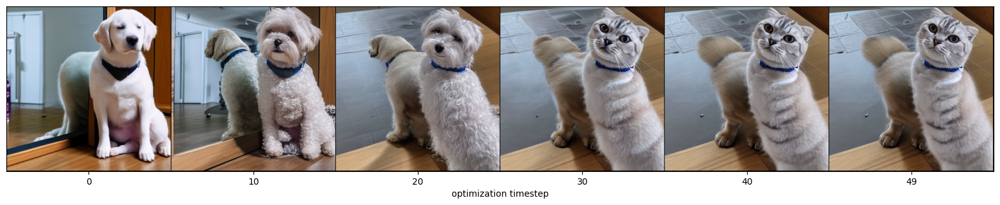

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```cat -> tiger```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "a photo of a tiger sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), num_inner_steps=60, verbose=True, uncond_embeddings=uncond_embeddings
)

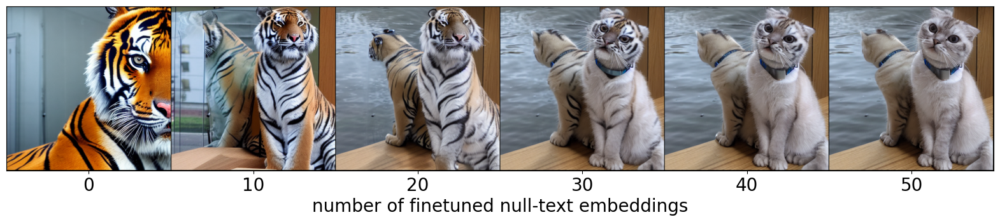

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

indicies = list(range(0, len(images_midstep), 10)) + [49]

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in np.asarray(images_midstep)[indicies]], nrow=len(images_midstep))
print
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(indicies)) / 2
x_ticks = np.arange(len(indicies)) * delta_x * 2  + delta_x
labels = np.arange(len(images_midstep))[indicies]
labels[-1] += 1
plt.xticks(ticks=x_ticks, labels=labels, fontsize=20)
plt.xlabel('number of finetuned null-text embeddings', fontsize=20)

plt.yticks(ticks=[])

plt.show()

```remove the cat```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "a photo of a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(image_path, prompt, offsets=(0,0,200,0), num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings)

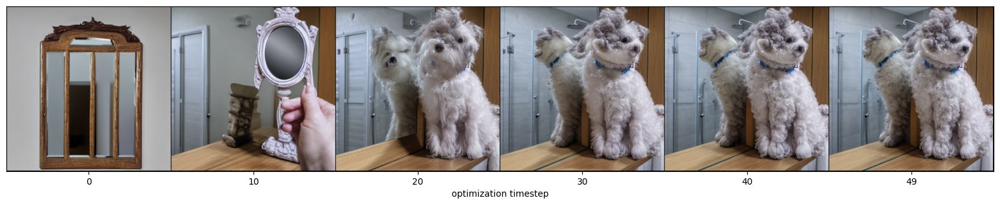

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make it a watercolor painting```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "watercolor painiting of a cat sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(image_path, prompt, offsets=(0,0,200,0), num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings)

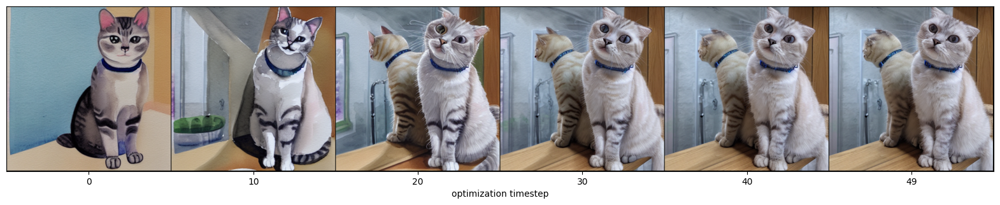

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```cat -> silver sculpture```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "a silver cat sculpture sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), verbose=True, uncond_embeddings=uncond_embeddings, num_inner_steps=50
)

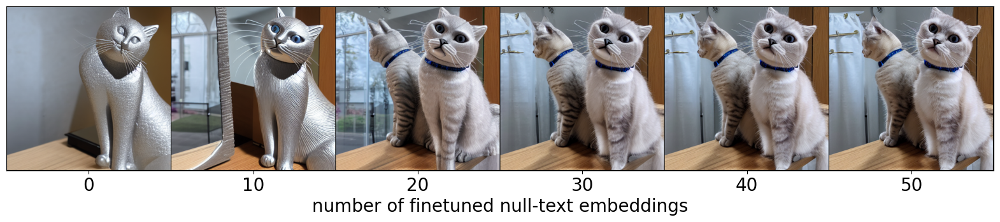

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

indicies = list(range(0, len(images_midstep), 10)) + [49]

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in np.asarray(images_midstep)[indicies]], nrow=len(images_midstep))
print
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(indicies)) / 2
x_ticks = np.arange(len(indicies)) * delta_x * 2  + delta_x
labels = np.arange(len(images_midstep))[indicies]
labels[-1] += 1
plt.xticks(ticks=x_ticks, labels=labels, fontsize=20)
plt.xlabel('number of finetuned null-text embeddings', fontsize=20)

plt.yticks(ticks=[])

plt.show()

```make it anime style```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "anime cat sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), verbose=True, uncond_embeddings=uncond_embeddings, num_inner_steps=30
)

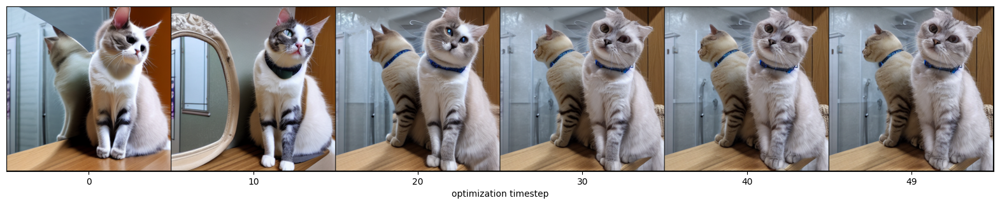

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make it Picasso style```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "Picasso painting of a cat sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), verbose=True, uncond_embeddings=uncond_embeddings, num_inner_steps=30
)

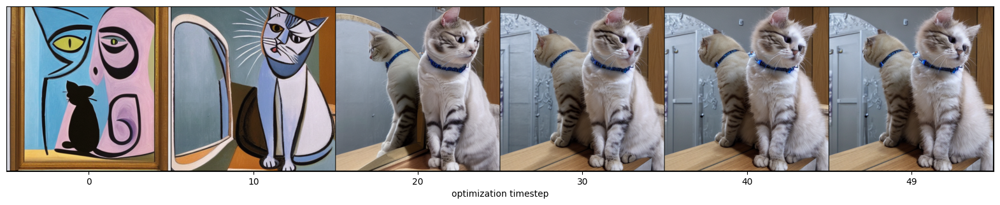

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make it an oil painting```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "oil painting of a cat sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), verbose=True, uncond_embeddings=uncond_embeddings, num_inner_steps=30
)

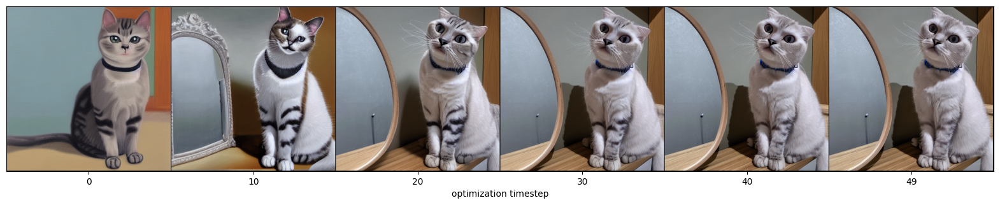

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make it a pixel style picture```

In [ ]:
image_path = "./gnochi_mirror.jpeg"
prompt = "pixel drawing of a cat sitting next to a mirror"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, offsets=(0,0,200,0), verbose=True, uncond_embeddings=uncond_embeddings, num_inner_steps=30
)

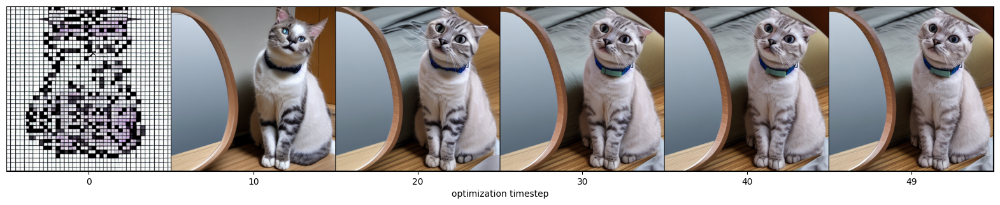

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

### A picture of a man eating a doughnut in the park

In [ ]:
image_path = "./man.jpeg"
prompt = "a man in glasses eating a doughnut in the park"
(image_gt, image_enc), x_t, uncond_embeddings, images_midstep = null_inversion.invert(
    image_path, prompt, verbose=True, need_images_midstep=False
)

```man -> woman```

In [ ]:
image_path = "./man.jpeg"
prompt = "a woman in glasses eating a doughnut in the park"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=15, verbose=True, uncond_embeddings=uncond_embeddings
)

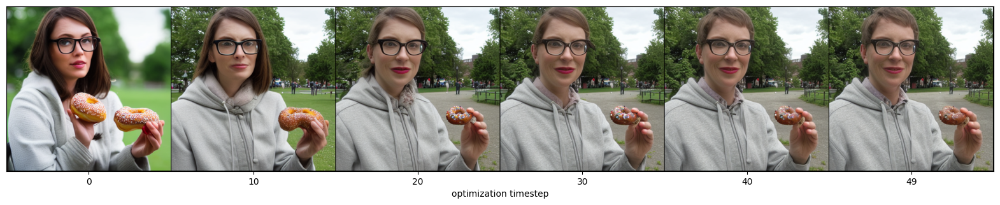

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make the hair red```

In [ ]:
image_path = "./man.jpeg"
prompt = "a red-haired man in glasses eating a doughnut in the park"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=50, verbose=True, uncond_embeddings=uncond_embeddings
)

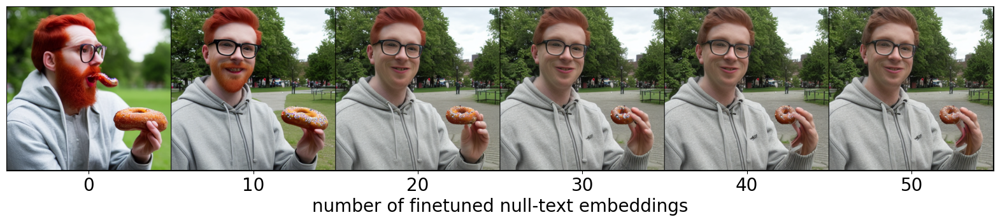

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

indicies = list(range(0, len(images_midstep), 10)) + [49]

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in np.asarray(images_midstep)[indicies]], nrow=len(images_midstep))
print
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(indicies)) / 2
x_ticks = np.arange(len(indicies)) * delta_x * 2  + delta_x
labels = np.arange(len(images_midstep))[indicies]
labels[-1] += 1
plt.xticks(ticks=x_ticks, labels=labels, fontsize=20)
plt.xlabel('number of finetuned null-text embeddings', fontsize=20)

plt.yticks(ticks=[])

plt.show()

```remove the glasses```

In [ ]:
image_path = "./man.jpeg"
prompt = "a man eating a doughnut in the park"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=50, verbose=True, uncond_embeddings=uncond_embeddings
)

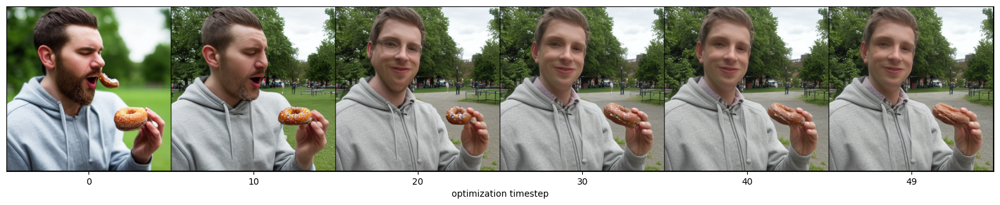

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```park -> desert```

In [ ]:
image_path = "./man.jpeg"
prompt = "a man in glasses eating a doughnut in the desert"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=50, verbose=True, uncond_embeddings=uncond_embeddings
)

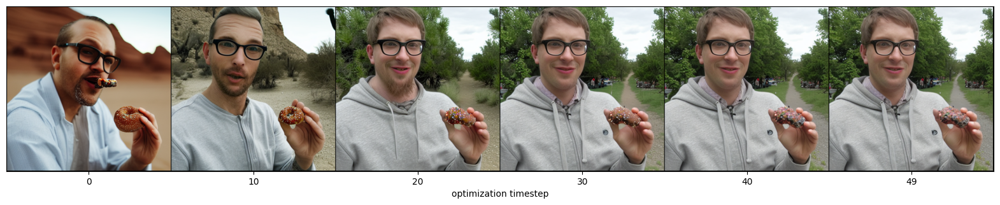

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

### A picture of a baby

In [ ]:
image_path = "./baby.jpeg"
prompt = "a baby wearing a blue shirt lying on the sofa"
(image_gt, image_enc), x_t, uncond_embeddings, images_midstep = null_inversion.invert(
    image_path, prompt, verbose=True, need_images_midstep=False
)

```blue shirt -> red shirt```

In [ ]:
image_path = "./baby.jpeg"
prompt = "a baby wearing a red shirt lying on the sofa"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

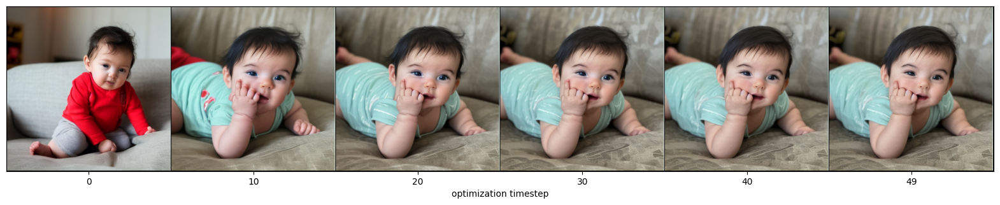

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make the hair blonde```

In [ ]:
image_path = "./baby.jpeg"
prompt = "a blonde baby wearing a blue shirt lying on the sofa"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

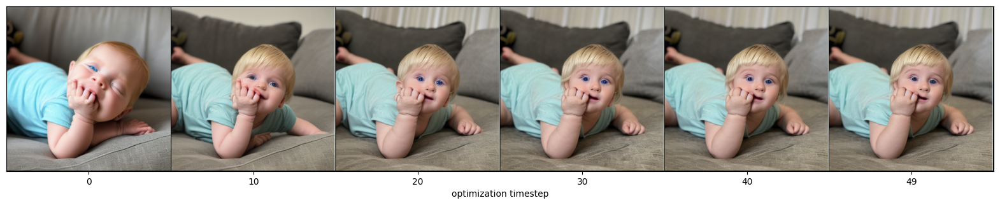

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```sofa -> grass```

In [ ]:
image_path = "./baby.jpeg"
prompt = "a baby wearing a blue shirt lying on the grass"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=50, verbose=True, uncond_embeddings=uncond_embeddings
)

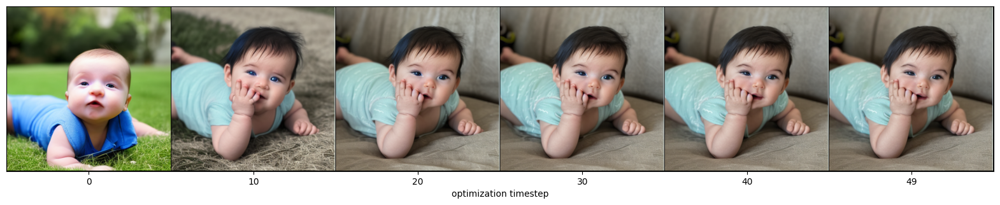

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```sofa -> ball pit```

In [ ]:
image_path = "./baby.jpeg"
prompt = "a baby wearing a blue shirt lying in the ball pit"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=15, verbose=True, uncond_embeddings=uncond_embeddings
)

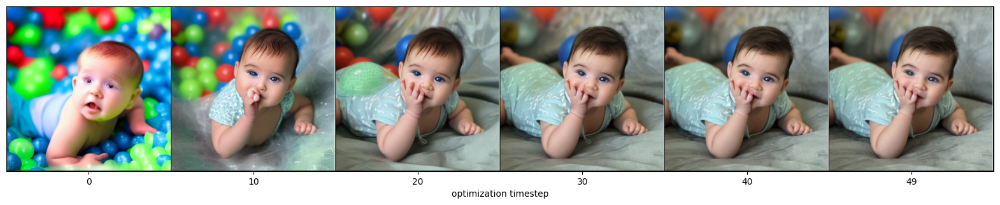

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

### A full face photo

In [ ]:
image_path = "./face.jpeg"
prompt = "a photo of a woman"
(image_gt, image_enc), x_t, uncond_embeddings, images_midstep = null_inversion.invert(
    image_path, prompt, verbose=True, need_images_midstep=False
)

```make the woman older```

In [ ]:
image_path = "./face.jpeg"
prompt = "a photo of an old woman"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

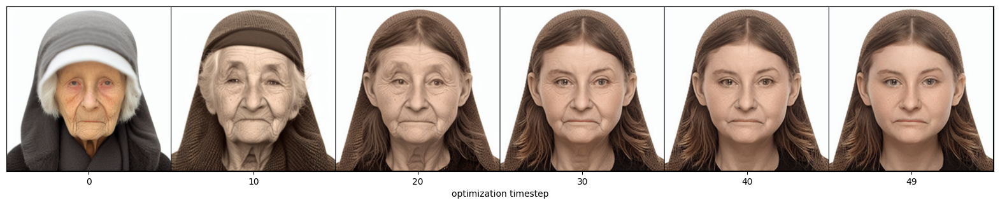

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make it anime style```

In [ ]:
image_path = "./face.jpeg"
prompt = "an anime style picture of an woman"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

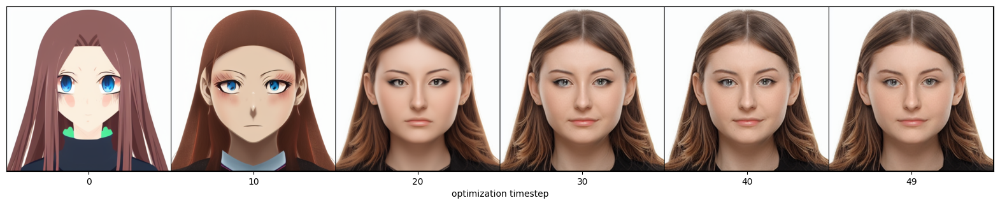

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```turn the woman into a vampire```

In [ ]:
image_path = "./face.jpeg"
prompt = "a photo of a vampire woman"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

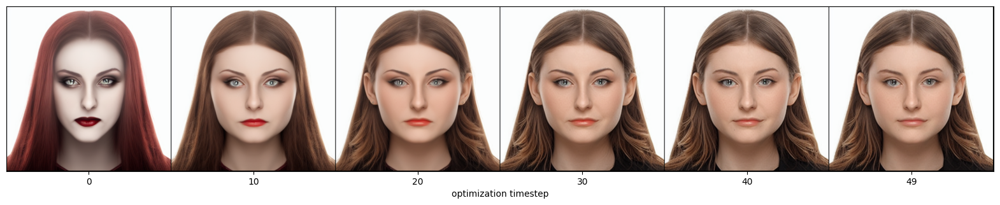

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make the hair blonde```

In [ ]:
image_path = "./face.jpeg"
prompt = "a photo of a blonde woman"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

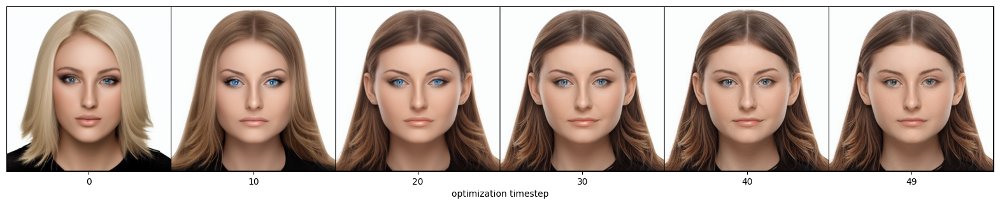

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make her smile```

In [ ]:
image_path = "./face.jpeg"
prompt = "a photo of a smiling woman"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

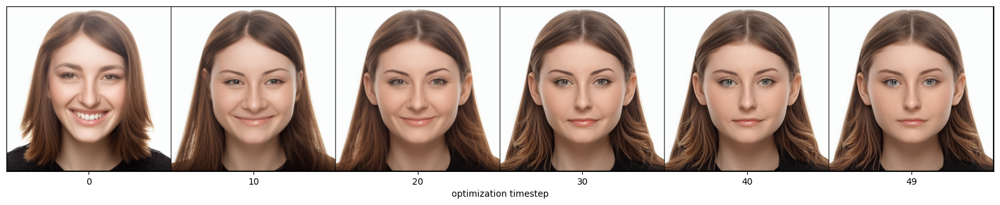

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```make her sad```

In [ ]:
image_path = "./face.jpeg"
prompt = "a photo of a sad woman"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

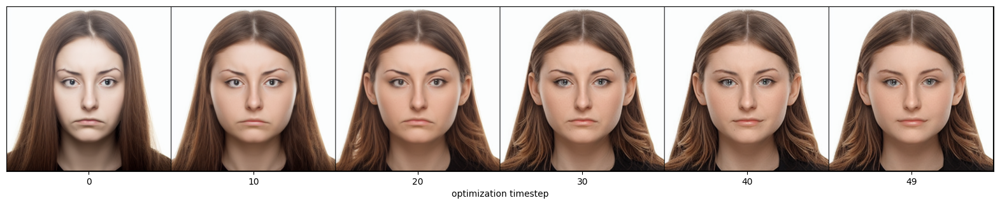

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```add glasses```

In [ ]:
image_path = "./face.jpeg"
prompt = "a photo of a woman wearing glasses"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

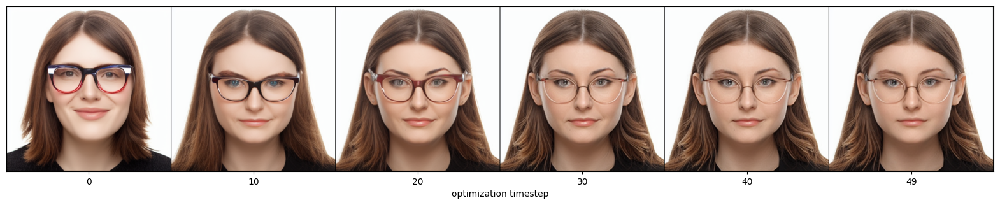

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

### Mona Lisa

In [ ]:
image_path = "./mona.jpeg"
prompt = "a painting of mona lisa"
(image_gt, image_enc), x_t, uncond_embeddings, images_midstep = null_inversion.invert(image_path, prompt, offsets=(0,0,0,0), verbose=True)

```make it a Modigliani style painting```

In [ ]:
image_path = "./mona.jpeg"
prompt = "Modigliani painting of mona lisa"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

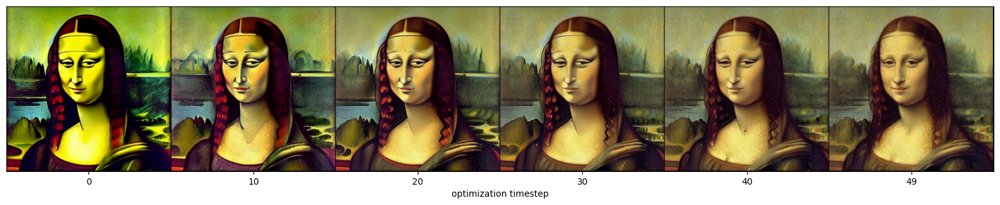

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

### The Beatles

In [ ]:
image_path = "./beatles.jpeg"
prompt = "a photo of the beatles crossing abbey road"
(image_gt, image_enc), x_t, uncond_embeddings, images_midstep = null_inversion.invert(image_path, prompt, offsets=(0,0,0,0), verbose=True)

```make it Minecraft style```

In [ ]:
image_path = "./beatles.jpeg"
prompt = "minecraft picture of the beatles crossing abbey road"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

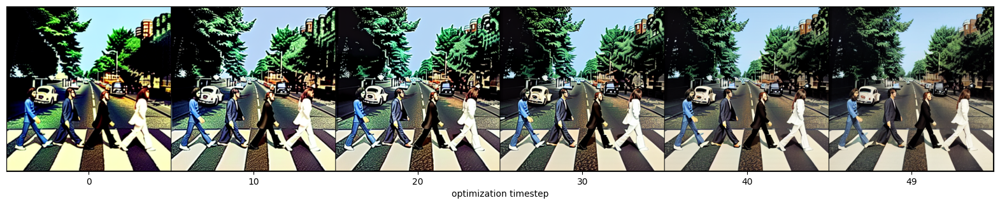

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

### A picture of a landscape

In [ ]:
image_path = "./landscape.jpeg"
prompt = "a photo of a lake in front of the mountains"
(image_gt, image_enc), x_t, uncond_embeddings, images_midstep = null_inversion.invert(image_path, prompt, verbose=True)

```add boats```

In [ ]:
image_path = "./landscape.jpeg"
prompt = "a photo of a lake with boats in front of the mountains"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

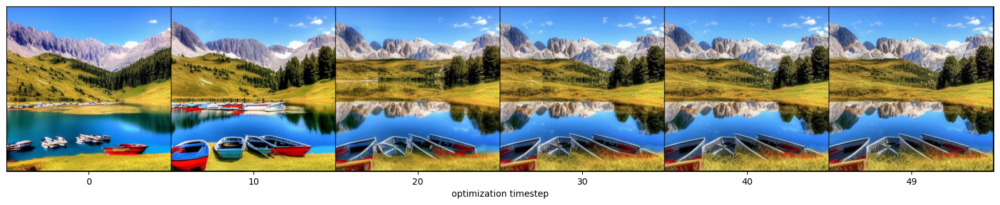

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()

```add a city skyline```

In [ ]:
image_path = "./landscape.jpeg"
prompt = "a photo of a lake in front of the city skyline"
(image_gt, image_enc), x_t, uncond_embeddings_new, images_midstep = null_inversion.invert(
    image_path, prompt, num_inner_steps=30, verbose=True, uncond_embeddings=uncond_embeddings
)

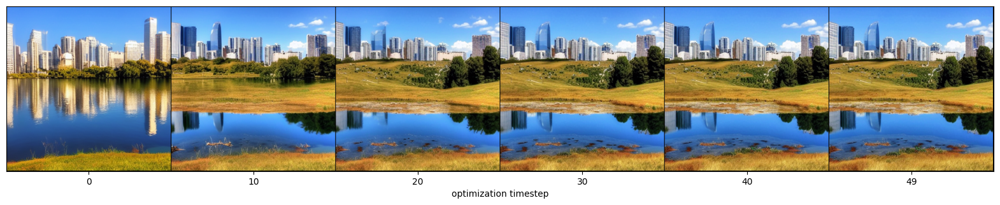

In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([torch.from_numpy(im).squeeze(0).permute(2, 0, 1) for im in images_midstep], nrow=len(images_midstep))
plt.figure(figsize=(20, 10))
plt.imshow(grid.permute(1, 2, 0))

delta_x = (grid.shape[2] / len(images_midstep)) / 2
x_ticks = np.arange(len(images_midstep)) * delta_x * 2  + delta_x
labels = [0, 10, 20, 30, 40, 49]
assert len(labels) == len(images_midstep)
plt.xticks(ticks=x_ticks, labels=labels)
plt.xlabel('optimization timestep')

plt.yticks(ticks=[])

plt.show()